# Fisheye Calibration and Rectification

This project involves performing fisheye calibration using OpenCV's fisheye calibration function and generating a rectified image to remove barrel distortion. An example of fisheye distortion correction is demonstrated below:


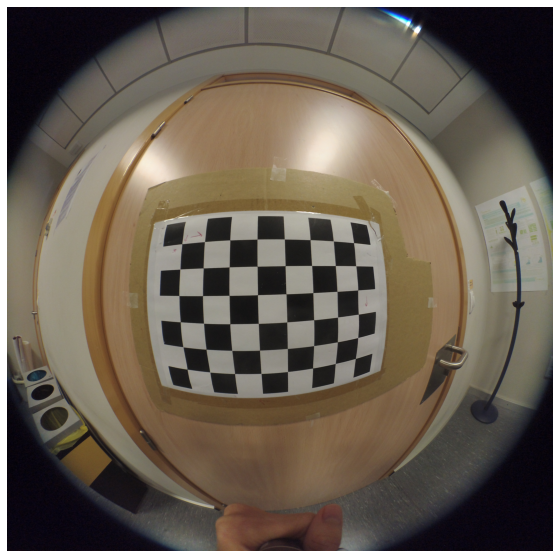
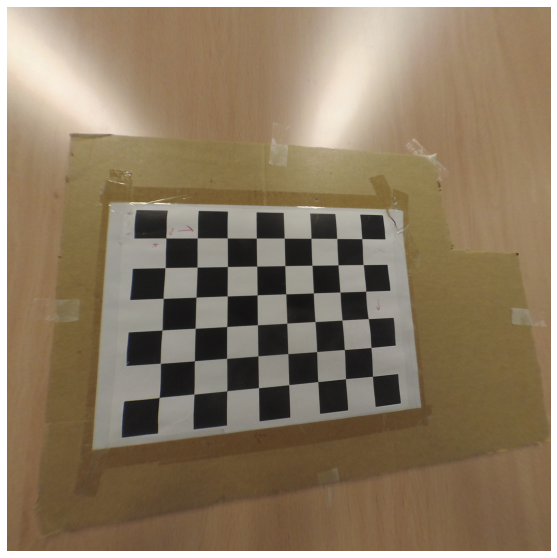


A set of 26 fisheye calibration images will be used for this project. The checkerboard pattern used in these images is an 8x6 target with a square size of 25mm.

Additionally, the reprojection error is calculated and visualized. The reprojection error represents the distance between a detected keypoint in a calibration image and its corresponding world point projected into the same image.
 
 # Example of Reprojection Error
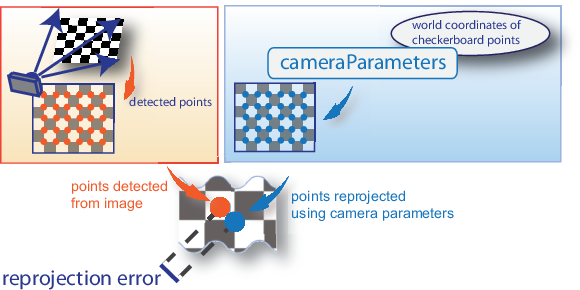

Debugging steps were taken to improve the mean reprojection error, along with suggestions for further improvements to enhance calibration accuracy.


## Libraries Used

In [1]:
%matplotlib inline
# import required libraries
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt

## Calibration Parameters
This section defines the calibration parameters used for fisheye correction:
- **Checkerboard shape**: 8x6 grid defined by the inner corners of the target.
- **Square size**: Each square on the checkerboard is 25mm.
- **Subpixel criteria**: Criteria used to refine corner locations to subpixel accuracy.
- **Calibration flags**: Specific flags set for the fisheye calibration function, excluding the "CALIB_CHECK_COND" flag for stability.
- **Object points and image points**: 3D points in real-world space and corresponding 2D points in image plane.


In [9]:
# Define the chess board rows and columns
CHECKERBOARD = (8,6)

# define the target square size
SQUARE_SIZE = 25  # square size in mm

# define the subpix_criteria
subpix_criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.1)

# define calibration_flags
#calibration_flags = cv2.fisheye.CALIB_RECOMPUTE_EXTRINSIC + cv2.fisheye.CALIB_CHECK_COND + cv2.fisheye.CALIB_FIX_SKEW
calibration_flags = cv2.fisheye.CALIB_RECOMPUTE_EXTRINSIC + cv2.fisheye.CALIB_FIX_SKEW

# define object points and image point variables
objp = np.zeros((1, CHECKERBOARD[0]*CHECKERBOARD[1], 3), np.float32)
objp[0,:,:2] = np.mgrid[0:CHECKERBOARD[0], 0:CHECKERBOARD[1]].T.reshape(-1, 2)*SQUARE_SIZE

objpoints = [] # 3d point in real world space
imgpoints = [] # 2d points in image plane.

# define number of images to be used
N_img = 26

## Fisheye Calibration Process
The fisheye calibration was performed using OpenCV's `cv2.fisheye.calibrate` function. The process involved:
- Reading all calibration images.
- Converting the images to grayscale.
- Finding chessboard corners in each image.
- Using the `cv2.fisheye.calibrate` function to perform camera calibration.

## Why Use a Checkerboard for Calibration?
- To calibrate, a known geeometric feature must be used. The checkerboard is precisely known and regular, which allows for easy calculation of real-world position with consistent reference points. Further, as the checkers are evenly distributed, this allows for accurate modelling of the lens distortion which often varies across the image plane. 

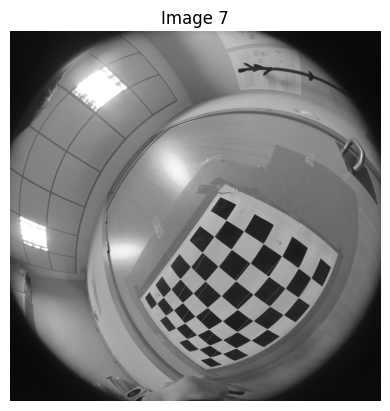

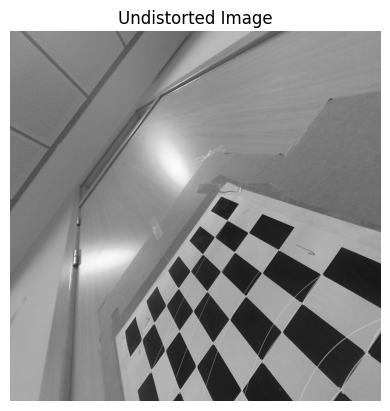

In [43]:
# load in all images into a list
image_list = []
for i in range(N_img):
    image_list.append(cv2.imread('images/cal%d.jpg' % (i+1)))

# Convert all images in the array to grayscale
gray_image_list = [cv2.cvtColor(image, cv2.COLOR_BGR2GRAY) for image in image_list]

# use the opencv cv2.fisheye.calibrate function to find the checkerboard corners in all the images
for gray_image in gray_image_list:
    # Find the chess board corners
    ret, corners = cv2.findChessboardCorners(gray_image, CHECKERBOARD, cv2.CALIB_CB_ADAPTIVE_THRESH + cv2.CALIB_CB_FAST_CHECK + cv2.CALIB_CB_NORMALIZE_IMAGE)
    
    # If found, add object points, image points (after refining them)
    if ret == True:
        objpoints.append(objp)
        
        # improve the accuracy of the corners using cornerSubPix
        corners2 = cv2.cornerSubPix(gray_image,corners,(3,3),(-1,-1),subpix_criteria)
        imgpoints.append(corners2)

# run fisheye calibration (cv2.fisheye.calibrate)
image_num = 7 # image number to display
image_num -= 1 # convert for indexing

# display images with the corners drawn on them
image = cv2.drawChessboardCorners(gray_image_list[image_num], CHECKERBOARD, imgpoints[image_num], ret)
plt.imshow(image, cmap='gray')
plt.axis('off')
plt.title('Image %d' % (image_num+1))
plt.show()

ret, K, D, rvecs, tvecs = cv2.fisheye.calibrate(objpoints, imgpoints, gray_image_list[image_num].shape[::-1], None, None, None, None, calibration_flags, (cv2.TERM_CRITERIA_EPS+cv2.TERM_CRITERIA_MAX_ITER, 30, 1e-6))

# demo distortion correction (cv2.fisheye.initUndistortRectifyMap)
DIM = gray_image_list[image_num].shape[::-1]
map1, map2 = cv2.fisheye.initUndistortRectifyMap(K, D, np.eye(3), K, DIM, cv2.CV_16SC2)
undistorted_img = cv2.remap(gray_image_list[image_num], map1, map2, interpolation=cv2.INTER_LINEAR, borderMode=cv2.BORDER_CONSTANT)

# display image
plt.imshow(undistorted_img, cmap='gray')
plt.axis('off')
plt.title('Undistorted Image')
plt.show()



# Comments
The fisheye calibration process involves determining the camera's intrinsic and extrinsic parameters using fisheye images of a known checkerboard pattern. 
This process corrects the fisheye lens distortion by optimizing these parameters, allowing for the accurate mapping of 3D points in the scene to 2D points in the image.



## Reprojection Error Calculation
A function was created to calculate the reprojection error for each image and the average reprojection error across all images. The reprojection error indicates how accurately the calibration process worked.
- The function returns both individual projection errors for each image and the overall mean reprojection error.
- A debug flag allows visualization of the detected versus reprojected points for deeper inspection.


In [49]:
def calculate_reprojection_error(objpoints, imgpoints, K, D, rvecs, tvecs, debug=False):
    avg_error = 0
    errors = []

    for i in range(len(objpoints)):
        # Obtain reprojections of each original point
        imgpoints2 = cv2.fisheye.projectPoints(objpoints[i], rvecs[i], tvecs[i], K, D)

        # Calculate the reprojection error by finding the norm between the original point and the reprojection
        error = cv2.norm(imgpoints[i].reshape(-1, 2), imgpoints2.reshape(-1, 2), cv2.NORM_L2)
        errors.append(error)
        avg_error += error

        # If in debug mode, plot original/reprojected points
        if debug:
            plt.subplot(13, 2, (i + 1))
            plt.imshow(cv2.cvtColor(image_list[i], cv2.COLOR_BGR2RGB))
            plt.axis('off'), plt.title("Comparison Image " + str(i + 1))

            # Using scatter for clear visualization: original points in red, reprojection points in blue
            plt.scatter(imgpoints[i].reshape(-1, 2)[:, 0], imgpoints[i].reshape(-1, 2)[:, 1], c='red', s=15, marker='o')
            plt.scatter(imgpoints2.reshape(-1, 2)[:, 0], imgpoints2.reshape(-1, 2)[:, 1], c='blue', s=5, marker='o')

    plt.show()

    avg_error = avg_error / len(objpoints)

    print("Average reprojection error = " + str(avg_error))

    return errors, avg_error


ValueError: num must be an integer with 1 <= num <= 26, not 27

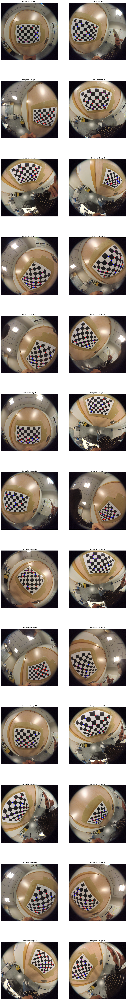

In [55]:
# Calculate the reprojection error for the calibration
errors, avg_error = calculate_reprojection_error(objpoints, imgpoints, K, D, rvecs, tvecs, True)

#calculate reprojection error by calling the calculate_reprojection_error function. 
print('Average reprojection error: ', avg_error)
print('Individual projection errors for each image: ', errors)

## Improving Calibration Performance
Analysis identified specific images where calibration was unsuccessful. Possible reasons include incomplete detection of the checkerboard pattern or high distortion levels.
Excluding these problematic images improved the overall calibration accuracy, as measured by a lower mean reprojection error.


In [57]:
# Calibration didn't work on images 3 and 17, and may have failed due to the checkerboard not being detected in all images.
# It may also have been because the checkerboard was not fully visible in all images, or the distortion could have been too high. 

total_error = 0
valid_samples = 0

for i in range(len(objpoints)):
    # Compute the reprojection error using the intrinsic parameters

    # Calculate the reprojection of each original point
    imgpoints2, _ = cv2.fisheye.projectPoints(objpoints[i], rvecs[i], tvecs[i], K, D)

    # Calculate the reprojection error by computing the norm between the original point and the reprojection
    error = cv2.norm(imgpoints[i].reshape(-1, 2), imgpoints2.reshape(-1, 2), cv2.NORM_L2)

    if error < 100:
        total_error += error
        valid_samples += 1

if valid_samples > 0:
    mean_error = total_error / valid_samples
    print("Average reprojection error for valid samples = " + str(mean_error))
else:
    print("No valid samples found for reprojection error calculation.")


Average reprojection error for valid samples = 12.662137125442037


# Comments
In conclusion, fisheye calibration was successfully performed using OpenCV's fisheye calibration function. The intrinsic and extrinsic parameters of a fisheye camera were calculated, image distortions were corrected, and the reprojection error was visualized to evaluate calibration accuracy. This work demonstrates the importance of accurate camera calibration in computer vision tasks, particularly when dealing with wide-angle lenses where distortion is significant.
## Potential Applications
- Robotics and Autonomous Navigation: Fisheye cameras can be used in robotics for navigation and obstacle detection as they give a wide FoV. Proper calibration is necessary for accurate location mapping and localization for these systems. 
- Security/Surveilance: Fisheye cameras used in security systems can monitor large areas, with calibration giving accurate representations of scenes for footage analysis. 

